In [4]:
from osgeo import gdal, ogr
import numpy as np
import tensorflow as tf
import glob
import datetime
import os

C:\Users\harry\anaconda3\envs\dl_tf\lib\site-packages\tensorflow\python\framework\dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
C:\Users\harry\anaconda3\envs\dl_tf\lib\site-packages\tensorflow\python\framework\dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
C:\Users\harry\anaconda3\envs\dl_tf\lib\site-packages\tensorflow\python\framework\dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
C:\Users\harry\anaconda3\envs\dl_tf\lib\site-packages\tensorflow\python\f

In [5]:
import descarteslabs as dl
import matplotlib.pyplot as plt

In [6]:
from training_data_utils import gdal_dataset_from_geocontext, create_chips_for_tile, TileJobConfig


# Define training sample locations

To generate training samples (image tiles or chips) we will use DLTiles to define the extent of each tile. This is a Descartes-Labs specific concept which provides a uniquely-identified scheme of tiles to cover any area with tiles of any specified size. To identify the areas within which we need to export the DLTile-bounded images, we're going to use two sets of polygons.

Firstly the labelled slum polygons. These are deemed as complete, for our entire area of interest - i.e. anything that is not labelled as slum can be considered to really not be slum. **We will need a different approach where this is not the case, which is currently anywhere other than Mumbai! We'll have to make our extent polygon through manual inspection to ensure we don't encompass any areas which look like slum but aren't flagged as such**.

Secondly an extent polygon. This will define the area within which we will create samples. Why do we need this? 

Unlike in the wellpads sample, we don't want to **only** cover the slum polygons, as we expect that in this case we will not capture a sufficient variety of non-slum areas for the model to be trained to recognise them; the only non-slum the model would then see would be the bits that happened to be within one tile's width of the edge of a slum. But at the same time we don't want to cover the entirety of the city (e.g. the bounding box of the slum areas). In this case the training data would probably be strongly biased towards non-slum, which may not be a good thing(?) , and in any case this would probably be an unfeasibly large area to cover.

Firstly I created and dissolved a buffer around the slum polygons of 250m - this value was somewhat empirical with the logic that it would cover ~2 full sample tiles around every slum (at 0.5m resolution and 256pixel tiles). Secondly I created a number of random point locations within the "universe" of analysis (for this I used the admin-1 boundaries of the city (Mumbai) and created 1000 points within these boundaries). Next I discarded the random points that were already within the slum buffer. For the remainder, I buffered them by 250m too. These combined buffers give our extent polygons.

We will create training samples to cover the entirety of the extent polygons, rasterising the label polygon dataset within this area.

In [3]:
in_extent_file = r"C:\Users\harry\OneDrive - Nexus365\Informal_Cities\ML_Slum_Prediction\Ground_Truthing_Data\Mumbai\Mumbai_Slums_with_random_pts_250m_buff_SP.geojson"
in_label_file = r"C:\Users\harry\OneDrive - Nexus365\Informal_Cities\ML_Slum_Prediction\Ground_Truthing_Data\Mumbai\02_Vectorisation\Mumbai_Slums_600dpi_attempt3_Thresholded_closed4px.shp"

In [4]:
import json
with open(in_extent_file) as f:
    poly = json.load(f)
extent_polygons = {"type":"FeatureCollection", "features":poly["features"]}

In [5]:
len(extent_polygons["features"])


180

In [6]:
TILE_SIZE = 64
TILE_PAD = 2
TILE_RES = 10
#PRODUCT = "airbus:oneatlas:phr:v2"
PRODUCT = "sentinel-2:L1C"
rgb_bands = "red green blue"
sentinel_bands = "coastal-aerosol blue green red red-edge red-edge-2 nir red-edge-4 water-vapor cirrus swir1 swir2"
BANDS = sentinel_bands #rgb_bands

In [10]:
label_ogr_ds = ogr.Open(in_label_file)
label_lyr = label_ogr_ds.GetLayerByIndex(0)

Get all DLTiles of the specified size and resolution that intersect the extent polygons

In [13]:
all_tiles = []
for f in extent_polygons["features"]:
    these_tiles = dl.scenes.DLTile.from_shape(f, TILE_RES, TILE_SIZE, TILE_PAD)
    print(str(len(these_tiles))+', ',end='')
    
    all_tiles.extend(these_tiles)

8, 6, 6, 9, 1, 2, 4, 4, 4, 9, 4, 7, 4, 4, 5, 3, 4, 17, 10, 4, 2, 13, 4, 3, 3, 2, 11, 4, 1, 8, 4, 24, 13, 6, 6, 4, 5, 6, 3, 3, 11, 4, 4, 5, 2, 2, 4, 2, 2, 4, 4, 6, 2, 1, 6, 2, 3, 5, 4, 4, 6, 3, 2, 3, 2, 4, 4, 2, 4, 5, 1, 4, 5, 4, 4, 3, 2, 4, 3, 9, 6, 12, 2, 9, 2, 4, 5, 1, 2, 4, 4, 4, 4, 4, 4, 4, 4, 1, 2, 5, 4, 5, 6, 2, 3, 2, 4, 4, 4, 4, 4, 4, 4, 4, 3, 3, 4, 4, 4, 4, 2, 4, 2, 3, 3, 4, 6, 3, 4, 4, 4, 4, 4, 3, 6, 5, 2, 4, 4, 3, 2, 4, 2, 4, 4, 4, 3, 4, 639, 4, 4, 4, 4, 4, 2, 4, 4, 4, 2, 3, 4, 4, 4, 2, 3, 4, 3, 5, 4, 4, 11, 4, 4, 4, 4, 7, 1, 4, 60, 4, 

In [14]:
all_tile_ids = [t.key for t in all_tiles]
len(all_tile_ids)


1469

Get a unique set of the tiles - because multiple input polygons may intersect the same DLTile, there are likely to be duplicates as we have searched for covering tiles separately for each polygon each turn. The  easiest way to avoid this would probably be to concatenate all shapes in to a single multipolygon and make a single call to DLTile.from_shape, but that's not very flexible.

DLTile is not hashable so we can't do set(all_tiles), instead we will use the string keys of the tiles as a comparator.
That would suggest this approach to creating the unique list of tiles:
``` python
unique_tile_ids = set(all_tile_ids)
unique_tiles = [dl.scenes.DLTile.from_key(k) for k in unique_tile_ids]
len(unique_tiles)
```
However, DON'T do this: it's VERY slow. I think that creating a DLTile.from_key must be server-side
so there are lots of round trips. Instead we'll compare on the key and use it to build the list of unique tiles. 
This is the Decorate-Sort-Undecorate pattern.

In [15]:
unique_tile_ids = set()
unique_tiles = []
for tile in all_tiles:
    k = tile.key
    if k not in unique_tile_ids:
        unique_tile_ids.add(k)
        unique_tiles.append(tile)

In [16]:
len(unique_tiles)

1208

#### Visualise the geometries

Let's plot the various polygons on a map so we can see what's up

First create a geopandas dataframe of the tile keys and geometries, which is a format that we can map easily

In [78]:
import geopandas as gpd

In [79]:
tile_geoms = gpd.GeoDataFrame([(t.key, t.geometry) for t in unique_tiles], columns=['tile_key', 'geometry'])
tile_geoms.crs = 'EPSG:4326'

Do the same for the labels (ground truth) file which is currently a shapefile rather than geojson

In [80]:
label_geoms = gpd.read_file(in_label_file)
label_geoms = label_geoms.drop(label_geoms[label_geoms['gridcode']==0].index)

Now add each to an interactive folium map with different colours

In [59]:
import folium

In [81]:
m = folium.Map(location=[19,73], zoom_start=11)

In [82]:
tstyle= {'fillColor': '#0055FFFF', 'color': '#0055FFFF'}
folium.GeoJson(tile_geoms, name='tile boundaries', style_function=lambda x:tstyle).add_to(m)

In [83]:
estyle={'fillColor': '#228B22', 'color': '#228B22'}
folium.GeoJson(extent_polygons, name='extent polygons', style_function=lambda x:estyle).add_to(m)

In [84]:
lstyle={'fillColor': '#FF0000', 'color': '#FF0000'}
folium.GeoJson(label_geoms, name='slum polygons', style_function=lambda x:lstyle).add_to(m)

In [85]:
folium.LayerControl().add_to(m)

In [86]:
m

## Create training samples.

In a separate file, we have defined a function to rasterise the label polygons within the geocontext specified. 
If attrib_to_burn isn't specified it will just burn all features as 1. 
If it is specified, it will burn the value of that attribute - use this if the label polygons cover everything (planar partition) and we want to burn different classes.

In [7]:
from training_data_utils import create_label_array

We have also defined a function to create a mosaic of scenes covering the geocontext specified. Given a reference date, the mosaic will cover the scenes that are closest in time to the reference date. In the case of the Mumbai data this isn't very close, as the labels represent 2011 and the Pleiades data are all post-2015, but still it's the best we can do.

In [8]:
from training_data_utils import create_img_array

The function can run for any product in the Descartes Labs catalog. Let's compare Pleaides with Sentinel

In [15]:
REF_DATE = datetime.date(2011,6,30)
#  17000 was an arbitrary one picked because it showed slum and non-slum
img_arr_sentinel = create_img_array(unique_tiles[17000], 'sentinel-2:L1C', REF_DATE)
img_arr = create_img_array(unique_tiles[17000], PRODUCT, REF_DATE)

IndexError: list index out of range

NameError: name 'img_arr_sentinel' is not defined

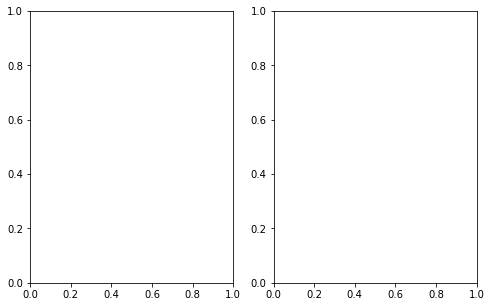

In [16]:
fig, ax = plt.subplots(1,2, figsize=(8,5))
# note that the sentinel data are 16-bit i.e. value range 0-65536, but in this area 
# values are mostly at the lower end, so normalise to 2000 for now.
ax[0].imshow(img_arr_sentinel / 2000.)
ax[1].imshow(img_arr)


In [68]:
img_arr.shape

(260, 260, 3)

In [42]:
lbl_arr = create_label_array(unique_tiles[17000], in_label_file, 'gridcode')

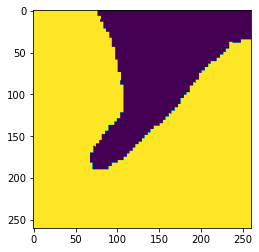

In [43]:
plt.imshow(lbl_arr)

In [67]:
lbl_arr.shape

(260, 260)

In [48]:
lbl_arr.mean()

0.735784023668639

#### Exporting the samples to geotiff tiles

Let's create training samples for all our tiles, now. We can do this in multiple processes to run faster.

I'm using a 12-core desktop machine, I'll run 20 jobs in parallel. This seems to work fine on a home broadband connection, i.e. the limiting factor is still how fast the api returns the data, so we can get away with running more jobs than there are cores. 

(For investigation: We could use the Descartes Tasks service to farm this out to *many* machines but it's probably an unnecessary complication at this stage - we'd then have to upload the data from each worker to the DL Storage service, and collate them back in from there at the end. Running on a reasonably decent single machine is fast enough for now).

We use a simple wrapper class to allow us to pass the DLTile object in joblib (it's not otherwise pickleable). 

Note that the functions we are using need to be defined in an external file rather than the notebook in order to work reliably with joblib, otherwise it's pretty hard to sort out the scope of them.

In [11]:
out_folder = r'E:\Temp\sentinel_10m_2pad'

In [18]:
unique_tiles[0]

DLTile(key='64:2:10.0:43:-361:3268',
       resolution=10.0,
       tilesize=64,
       pad=2,
       crs='EPSG:32643',
       bounds=(268940.0, 2091500.0, 269620.0, 2092180.0),
       bounds_crs='EPSG:32643',
       geometry=<shapely.geom...0022A529CA888>,
       zone=43,
       ti=-361,
       tj=3268,
       geotrans=[
  268940.0,...  0,
  -10.0
],
       proj4='+proj=utm +z...s=m +no_defs ',
       wkt='PROJCS["WGS ...SG","32643"]]')

In [19]:
from joblib import Parallel, delayed
import multiprocessing
inputs = list(unique_tiles)#[:100]

In [20]:
inputs = [TileJobConfig(t, out_folder, PRODUCT, REF_DATE, in_label_file, 'gridcode', BANDS) for t in inputs]

In [21]:
len(inputs)

1208

In [22]:
res = Parallel(n_jobs=20)(delayed(create_chips_for_tile)(t) for t in inputs)

## Convert classified image folders to tfrecords

For each pair of image/label files, we want to create a tensorflow Example and then write those to a .tfrecords file.

In order to be able to parallelise this step, we'll create sharded output files i.e. one .tfrecords for each worker.

We have the paths to the tiffs as returned from the create_chips_for_tile function. If we haven't run it in this 
session then we could of course just glob() to get them back.

In [9]:
len(res), res[0]

NameError: name 'res' is not defined

In [30]:
import glob
images = sorted(glob.glob(os.path.join(out_folder, 'images', '*.tif')))
labels = sorted(glob.glob(os.path.join(out_folder, 'labels', '*.tif')))
res = list(zip(images,labels))

In [31]:
res[0]

('E:\\Temp\\sentinel_10m_2pad\\images\\64#2#10.0#43#-332#3311.tif',
 'E:\\Temp\\sentinel_10m_2pad\\labels\\64#2#10.0#43#-332#3311.tif')

In [28]:
img_files = tf.constant([tpl[0] for tpl in res])
lbl_files = tf.constant([tpl[1] for tpl in res])

In [29]:
ds = tf.data.Dataset.from_tensor_slices((img_files, lbl_files))

In [14]:
import rasterio
from rasterio.plot import reshape_as_raster, reshape_as_image

In [15]:
with rasterio.open(res[0][0]) as src:
    arr = src.read()

In [18]:
arr = reshape_as_image(arr)
arr.shape

(68, 68, 12)

In [20]:
def _process_image(filename):
    with rasterio.open(img_path) as src:
        img_arr = src.read() # reads all bands to 3d array bands,rows,cols
    
    img_arr = reshape_as_image(img_arr) #  converts dim order to rows,cols,bands
    return img_arr, arr.shape

def _process_image_files_batch(coder, thread_index, ranges, name, filenames,
                               texts, labels, num_shards):
    """Processes and saves list of images as TFRecord in 1 thread.
  Args:
    coder: instance of ImageCoder to provide TensorFlow image coding utils.
    thread_index: integer, unique batch to run index is within [0, len(ranges)).
    ranges: list of pairs of integers specifying ranges of each batches to
      analyze in parallel.
    name: string, unique identifier specifying the data set
    filenames: list of strings; each string is a path to an image file
    texts: list of strings; each string is human readable, e.g. 'dog'
    labels: list of integer; each integer identifies the ground truth
    num_shards: integer number of shards for this data set.
    """
    # Each thread produces N shards where N = int(num_shards / num_threads).
    # For instance, if num_shards = 128, and the num_threads = 2, then the first
    # thread would produce shards [0, 64).
    num_threads = len(ranges)
    assert not num_shards % num_threads
    num_shards_per_batch = int(num_shards / num_threads)

    shard_ranges = np.linspace(ranges[thread_index][0],
                             ranges[thread_index][1],
                             num_shards_per_batch + 1).astype(int)
    num_files_in_thread = ranges[thread_index][1] - ranges[thread_index][0]

    counter = 0
    for s in range(num_shards_per_batch):
        # Generate a sharded version of the file name, e.g. 'train-00002-of-00010'
        shard = thread_index * num_shards_per_batch + s
        output_filename = '%s-%.5d-of-%.5d' % (name, shard, num_shards)
        output_file = os.path.join(FLAGS.output_directory, output_filename)
        writer = tf.python_io.TFRecordWriter(output_file)

        shard_counter = 0
        files_in_shard = np.arange(shard_ranges[s], shard_ranges[s + 1], dtype=int)
        for i in files_in_shard:
            filename = filenames[i]
            label = labels[i]
            text = texts[i]

            try:
                image_buffer, image_shape = _process_image(filename)
                lbl_buffer, label_shape = _process_image(label)
            except Exception as e:
                print(e)
                print('SKIPPED: Unexpected eror while decoding %s.' % filename)
                continue

            example = convert_to_example(image_buffer, lbl_buffer, imag 
                                    height, width)
            writer.write(example.SerializeToString())
            shard_counter += 1
            counter += 1

            if not counter % 1000:
                print('%s [thread %d]: Processed %d of %d images in thread batch.' %
                  (datetime.now(), thread_index, counter, num_files_in_thread))
                sys.stdout.flush()

        writer.close()
        print('%s [thread %d]: Wrote %d images to %s' %
          (datetime.now(), thread_index, shard_counter, output_file))
        sys.stdout.flush()
        shard_counter = 0
    print('%s [thread %d]: Wrote %d images to %d shards.' %
        (datetime.now(), thread_index, counter, num_files_in_thread))
    sys.stdout.flush()
    
    
    
def _process_image_files(name, img_files,lbl_files, num_shards, num_threads):
    """Process and save list of images as TFRecord of Example protos.
    Args:
    name: string, unique identifier specifying the data set
    filenames: list of strings; each string is a path to an image file
    labels: list of strings; each string is a path to a label file
    num_shards: integer number of shards for this data set.
    """
    assert len(img_files) == len(lbl_files)

    # Break all images into batches with a [ranges[i][0], ranges[i][1]].
    spacing = np.linspace(0, len(img_files), num_threads + 1).astype(np.int)
    ranges = []
    for i in range(len(spacing) - 1):
        ranges.append([spacing[i], spacing[i + 1]])

    # Launch a thread for each batch.
    print('Launching %d threads for spacings: %s' % (num_threads, ranges))
    sys.stdout.flush()

    # Create a mechanism for monitoring when all threads are finished.
    coord = tf.train.Coordinator()

    # Create a generic TensorFlow-based utility for converting all image codings.
    coder = ImageCoder()

    threads = []
    for thread_index in range(len(ranges)):
        args = (coder, thread_index, ranges, name, filenames,
            texts, labels, num_shards)
        t = threading.Thread(target=_process_image_files_batch, args=args)
        t.start()
        threads.append(t)

    # Wait for all the threads to terminate.
    coord.join(threads)
    print('%s: Finished writing all %d images in data set.' %
        (datetime.now(), len(filenames)))
    sys.stdout.flush()

In [32]:
with rasterio.open(res[0][1]) as src:
    lbl_arr = src.read()

In [35]:
lbl_arr.shape

(1, 68, 68)

In [30]:
def _parse_func(img_path, lbl_path):
    with rasterio.open(img_path) as src:
        img_arr = src.read() # reads all bands to 3d array bands,rows,cols
    img_arr = reshape_as_image(img_arr) #  converts dim order to rows,cols,bands
    

<DatasetV1Adapter shapes: ((), ()), types: (tf.string, tf.string)>

In [ ]:

# convert classified image folders to tfrecords

def tfrecord_from_images(imgpath, lblpath):
    #  parse the dl tile key back out of the filename
    dl_tile_key = os.path.basename(imgpath).split()
infiles = glob.glob(r'E:\Temp\mumbai_esri_train2m\images\*.tif')
len(infiles)